# Pre-Processing of Data

In [1]:
# Misc
import os
import sys
from timeit import default_timer as timer 
import datetime
now = datetime.datetime.now()

# Data manipulation
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from netCDF4 import Dataset
import numpy as np
import plotly.graph_objects as go
from scipy.optimize import curve_fit
from scipy.stats import norm


# Sanity check for jupyter notebooks
print("Current working directory:", os.getcwd())

Current working directory: c:\Users\gabri\Documents\GitHub\IceClassic\sandbox\content


# Loading the dataframe
The source and explanation of each column is in the txt.

In [2]:
Data=pd.read_csv('https://github.com/GabrielFollet/ICE_data_dump/blob/main/DATA.txt?raw=true',index_col=0,delimiter='\t',skiprows=97)
print(Data.columns)

Index(['TAVG [C]', 'Days since start of year', 'Days until break up',
       'Predicted ice thickness [m]', 'Noisy predicted ice thickness [m]',
       'PRCP', 'SNOW', 'SNWD', 'TMAX', 'TMIN', 'Max water temp [C]',
       'Min water temp [C]', 'Mean water temp [C]', 'Mean Discharge [m3/s]_x',
       'Mean Discharge [m3/s]_y', 'IceThickness [cm]',
       'Solar Surface Irradiance [W/m2]', 'Cloud coverage [%]'],
      dtype='object')


# Visualizing the dataframe


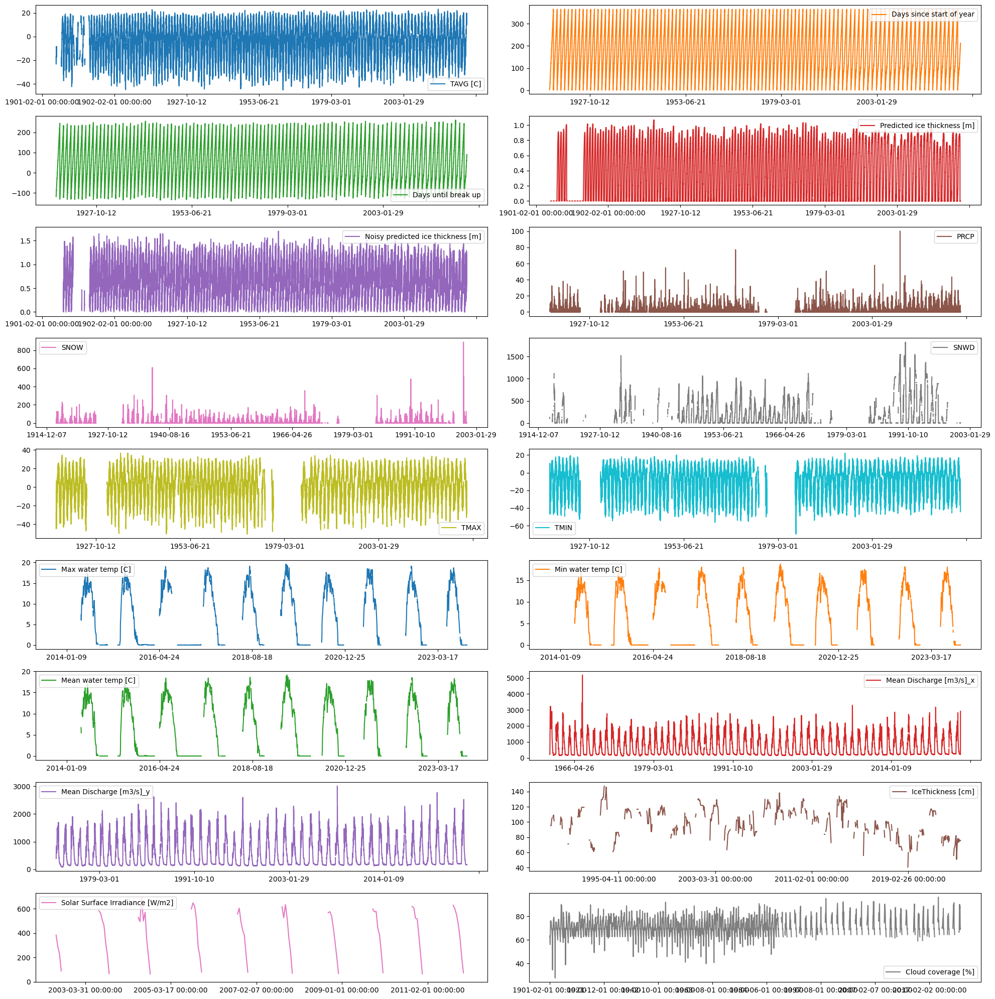

In [64]:
# # Normal Plots
fig, ax = plt.subplots(nrows=9, ncols=2, figsize=(20,20))
Data.plot(subplots=True, ax=ax)

# Adjust layout to prevent overlap
plt.tight_layout()

plt.show()



# Initialize figure
fig = go.Figure()

# Add Traces ( plots elements)
fig.add_trace(go.Scatter(x=Data.index,y=Data["TAVG [C]"],name="Air temp",yaxis="y",line=dict(color='gold')))
fig.add_trace(go.Scatter(x=Data.index,y=Data["Predicted ice thickness [m]"]*100,name="Predicted ice thickness",yaxis="y4",line=dict(color='lime')))
fig.add_trace(go.Scatter(x=ice_thickness.index,y=ice_thickness["IceThickness [cm]"],name="Ice thickness",yaxis="y4",line=dict(color='navy')))
fig.add_trace(go.Scatter(x=Data.index,y=Data["PRCP"],name="Rainfall",yaxis="y2",line=dict(color='lightseagreen')))
fig.add_trace(go.Scatter(x=Data.index,y=Data["SNOW"],name="Snowfall",yaxis="y2",line=dict(color='slateblue')))
fig.add_trace(go.Scatter(x=Data.index,y=Data["SNWD"],name='Snow depth',yaxis="y2",line=dict(color='magenta')))
fig.add_trace(go.Scatter(x=Data.index,y=Data['Max water temp [C]'],name="Water temp",yaxis="y",line=dict(color='firebrick')))
fig.add_trace(go.Scatter(x=Data.index,y=Data['Mean Discharge [m3/s]_x'],name="Discharge",yaxis="y3",line=dict(color='dodgerblue')))
fig.add_trace(go.Scatter(x=Data.index,y=Data["Cloud coverage [%]"],name="Cloud coverage",yaxis="y5",line=dict(color='slategray')))
fig.add_trace(go.Scatter(x=Data.index,y=Data["Solar Surface Irradiance [W/m2]"],name="Solar Surface Irradiance",yaxis="y6",line=dict(color='orangered')))
# dropdown menu to select which timseries to plot
fig.update_layout(
    updatemenus=[
        dict(active=0,
            buttons=list([
                dict(label="All",method="update",args=[{"visible": [True, True, True,True,True, True, True,True,True,True]}]),
                dict(label="Temperature",method="update",args=[{"visible":  [True, False, False,False,False, False,True,False,False,False]}]),
                dict(label="Ice+Snow",method="update",args=[{"visible":    [False,True,True,False,True,True,False,False,False,False]}]),
                dict(label="Discharge+Rain",method="update",args=[{"visible":   [False, False, False,True,False, False,False,True,False,False]}]),
                dict(label="Clouds+Solar Radiation",method="update",args=[{"visible":   [False, False, False,False,False, False,False,False,True,True]}])]),)])

# Set title and axis properties
fig.update_layout(
    title="Break up times & Global Variables at Tenana River-Nenana,AK",
    showlegend=True,
    xaxis=dict(range=["1990-01-01","1995-12-31"],rangeslider=dict(autorange=True),type="date"),
    yaxis=dict(anchor="x",autorange=True,domain=[0, 0.17],linecolor="black",mirror=True,range=[-55.0, 25],
            showline=True,side="left",tickfont={"color": "black"},tickmode="auto",ticks="",title="[C]",
            titlefont={"color": "black"},type="linear",zeroline=False),
    yaxis2=dict(anchor="x",autorange=True,domain=[0.17, 0.34],linecolor="black",mirror=True,range=[0, 40],
            showline=True,side="left",tickfont={"color": "black"},tickmode="auto",ticks="",title="[mm]",
            titlefont={"color": "black"},type="linear",zeroline=False),
    yaxis3=dict(anchor="x",autorange=True,domain=[0.34, 0.51],linecolor="black",mirror=True,range=[0,30],
            showline=True,side="left",tickfont={"color": "black"},tickmode="auto",ticks="",title="[m3/s]",
            titlefont={"color": "black"},type="linear",zeroline=False),
    yaxis4=dict(anchor="x",autorange=True,domain=[0.51, .68],linecolor="black",mirror=True,range=[0,200],
            showline=True,side="left",tickfont={"color": "black"},tickmode="auto",ticks="",title="[cm]",
            titlefont={"color": "black"},type="linear",zeroline=False),
    yaxis5=dict(anchor="x",autorange=True,domain=[0.68, 0.85],linecolor="black",mirror=True,range=[0,200],
            showline=True,side="left",tickfont={"color": "black"},tickmode="auto",ticks="",title="[%]",
            titlefont={"color": "black"},type="linear",zeroline=False),
    yaxis6=dict(anchor="x",autorange=True,domain=[0.85, 1],linecolor="black",mirror=True,range=[0,200],
            showline=True,side="left",tickfont={"color": "black"},tickmode="auto",ticks="",title="[W/m2]",
            titlefont={"color": "black"},type="linear",zeroline=False))



# Update layout
fig.update_layout(
    dragmode="zoom",hovermode="x",legend=dict(traceorder="reversed"),height=800,template="plotly",
        margin=dict(t=90,b=90),)

fig.show()


We have added the **["Days until break up']** and **['Days since start of year']** columns to plot the variables before and after the break up

#

In [66]:

# Initialize figure
fig = go.Figure()

# Add Traces ( plots elements)
fig.add_trace(go.Scatter(x=Data.index,y=Data["Predicted ice thickness [m]"]*100,name="Predicted ice thickness",yaxis="y4",line=dict(color='lime')))
fig.add_trace(go.Scatter(x=ice_thickness.index,y=ice_thickness["IceThickness [cm]"],name="Ice thickness",yaxis="y4",line=dict(color='navy')))
fig.add_trace(go.Scatter(x=Data.index,y=Data["SNWD"]/10,name='Snow depth',yaxis="y4",line=dict(color='magenta')))
# Set title and axis properties
fig.update_layout(
    title="Predicted ice thickness",
    showlegend=True,
    xaxis=dict(range=["1990-01-01","1995-12-31"],rangeslider=dict(autorange=True),type="date"),
    yaxis4=dict(anchor="x",autorange=True,linecolor="black",mirror=True,range=[0,200],
            showline=True,side="left",tickfont={"color": "black"},tickmode="auto",ticks="",title="[cm]",
            titlefont={"color": "black"},type="linear",zeroline=False))

fig.update_layout(
    dragmode="zoom",hovermode="x",legend=dict(traceorder="reversed"),height=800,template="plotly",
        margin=dict(t=90,b=150),)

fig.show()
